# Setup

In [1]:
!pip install -q kaggle
!pip install -q ydata_profiling
!pip install -q imbalanced-learn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 398.7/398.7 kB 17.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.7/296.7 kB 19.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 73.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.7/679.7 kB 36.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 1.5 MB/s eta 0:00:00


In [2]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"saatvikmtech","key":"e675c36acec415887dcabdbf052957ab"}'}

In [3]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [4]:
!kaggle datasets download -d gauravduttakiit/smoker-status-prediction-using-biosignals
!unzip smoker-status-prediction-using-biosignals.zip

Dataset URL: https://www.kaggle.com/datasets/gauravduttakiit/smoker-status-prediction-using-biosignals
License(s): apache-2.0
  0% 0.00/1.30M [00:00<?, ?B/s]
100% 1.30M/1.30M [00:00<00:00, 731MB/s]
Archive:  smoker-status-prediction-using-biosignals.zip
  inflating: test_dataset.csv        
  inflating: train_dataset.csv       


# Exploratory Data Analysis

In [5]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
from ydata_profiling import ProfileReport

In [6]:
df = pd.read_csv('train_dataset.csv')
df

,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,relaxation,...,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,smoking
0,35,170,85,97.0,0.9,0.9,1,1,118,78,...,70,142,19.8,1,1.0,61,115,125,1,1
1,20,175,110,110.0,0.7,0.9,1,1,119,79,...,71,114,15.9,1,1.1,19,25,30,1,0
2,45,155,65,86.0,0.9,0.9,1,1,110,80,...,57,112,13.7,3,0.6,1090,1400,276,0,0
3,45,165,80,94.0,0.8,0.7,1,1,158,88,...,46,91,16.9,1,0.9,32,36,36,0,0
4,20,165,60,81.0,1.5,0.1,1,1,109,64,...,47,92,14.9,1,1.2,26,28,15,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38979,40,165,60,80.0,0.4,0.6,1,1,107,60,...,61,72,12.3,1,0.5,18,18,21,1,0
38980,45,155,55,75.0,1.5,1.2,1,1,126,72,...,76,131,12.5,2,0.6,23,11,12,0,0
38981,40,170,105,124.0,0.6,0.5,1,1,141,85,...,48,138,17.1,1,0.8,24,23,35,1,1
38982,40,160,55,75.0,1.5,1.5,1,1,95,69,...,79,116,12.0,1,0.6,24,20,17,0,1


In [7]:
print(df.duplicated().sum())
df.drop_duplicates(inplace=True)

5517


## Univariate Analysis

In [8]:
df.describe()

,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,relaxation,...,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,smoking
count,33467.000000,33467.000000,33467.000000,33467.000000,33467.000000,33467.000000,33467.000000,33467.000000,33467.000000,33467.000000,...,33467.000000,33467.000000,33467.000000,33467.000000,33467.000000,33467.000000,33467.000000,33467.000000,33467.000000,33467.000000
mean,44.153943,164.684465,65.930319,82.081501,1.013849,1.009553,1.025368,1.026056,121.498730,76.017599,...,57.257537,115.182090,14.624463,1.086533,0.886467,26.195536,27.139929,39.952401,0.214689,0.366271
std,12.071768,9.195867,12.877955,9.310533,0.496245,0.497867,0.157243,0.159303,13.671019,9.672070,...,14.598021,43.159159,1.562414,0.403008,0.222038,18.760580,31.613159,49.965736,0.410613,0.481792
min,20.000000,130.000000,30.000000,51.000000,0.100000,0.100000,1.000000,1.000000,71.000000,40.000000,...,4.000000,1.000000,4.900000,1.000000,0.100000,6.000000,1.000000,2.000000,0.000000,0.000000
25%,40.000000,160.000000,55.000000,76.000000,0.800000,0.800000,1.000000,1.000000,112.000000,70.000000,...,47.000000,92.000000,13.600000,1.000000,0.800000,19.000000,15.000000,17.000000,0.000000,0.000000
50%,40.000000,165.000000,65.000000,82.000000,1.000000,1.000000,1.000000,1.000000,120.000000,76.000000,...,55.000000,113.000000,14.800000,1.000000,0.900000,23.000000,21.000000,26.000000,0.000000,0.000000
75%,55.000000,170.000000,75.000000,88.000000,1.200000,1.200000,1.000000,1.000000,130.000000,82.000000,...,66.000000,136.000000,15.700000,1.000000,1.000000,29.000000,31.000000,44.000000,0.000000,1.000000
max,85.000000,190.000000,135.000000,129.000000,9.900000,9.900000,2.000000,2.000000,233.000000,146.000000,...,359.000000,1860.000000,21.100000,6.000000,11.600000,1090.000000,2914.000000,999.000000,1.000000,1.000000


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 33467 entries, 0 to 38983
Data columns (total 23 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   age                  33467 non-null  int64  
 1   height(cm)           33467 non-null  int64  
 2   weight(kg)           33467 non-null  int64  
 3   waist(cm)            33467 non-null  float64
 4   eyesight(left)       33467 non-null  float64
 5   eyesight(right)      33467 non-null  float64
 6   hearing(left)        33467 non-null  int64  
 7   hearing(right)       33467 non-null  int64  
 8   systolic             33467 non-null  int64  
 9   relaxation           33467 non-null  int64  
 10  fasting blood sugar  33467 non-null  int64  
 11  Cholesterol          33467 non-null  int64  
 12  triglyceride         33467 non-null  int64  
 13  HDL                  33467 non-null  int64  
 14  LDL                  33467 non-null  int64  
 15  hemoglobin           33467 non-null  floa

In [10]:
df.nunique().sort_values(ascending=False)

,0
waist(cm),545
Gtp,439
triglyceride,389
LDL,286
Cholesterol,279
fasting blood sugar,258
ALT,230
AST,195
hemoglobin,143
systolic,125


In [11]:
categorical_cols = ['hearing(left)', 'hearing(right)', 'Urine protein', 'dental caries', 'smoking']
for col in categorical_cols:
    print(f"\nColumn: {col}")
    print(df[col].value_counts())


Column: hearing(left)
hearing(left)
1    32618
2      849
Name: count, dtype: int64

Column: hearing(right)
hearing(right)
1    32595
2      872
Name: count, dtype: int64

Column: Urine protein
Urine protein
1    31623
2     1068
3      562
4      157
5       52
6        5
Name: count, dtype: int64

Column: dental caries
dental caries
0    26282
1     7185
Name: count, dtype: int64

Column: smoking
smoking
0    21209
1    12258
Name: count, dtype: int64


In [12]:
continuous_cols = [col for col in df.columns if col not in categorical_cols]
print(continuous_cols)

['age', 'height(cm)', 'weight(kg)', 'waist(cm)', 'eyesight(left)', 'eyesight(right)', 'systolic', 'relaxation', 'fasting blood sugar', 'Cholesterol', 'triglyceride', 'HDL', 'LDL', 'hemoglobin', 'serum creatinine', 'AST', 'ALT', 'Gtp']


/tmp/ipython-input-705419456.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=value_counts.index, y=value_counts.values, palette="viridis", ax=ax1)
/tmp/ipython-input-705419456.py:13: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45, ha='right', fontsize=10)


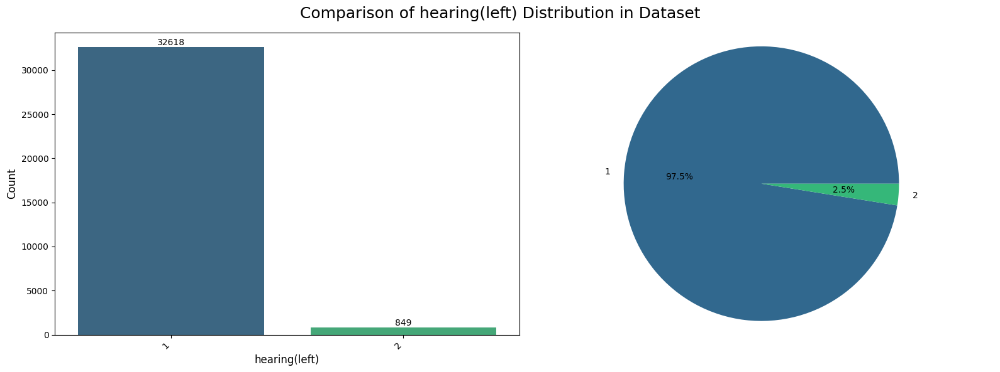

/tmp/ipython-input-705419456.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=value_counts.index, y=value_counts.values, palette="viridis", ax=ax1)
/tmp/ipython-input-705419456.py:13: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45, ha='right', fontsize=10)


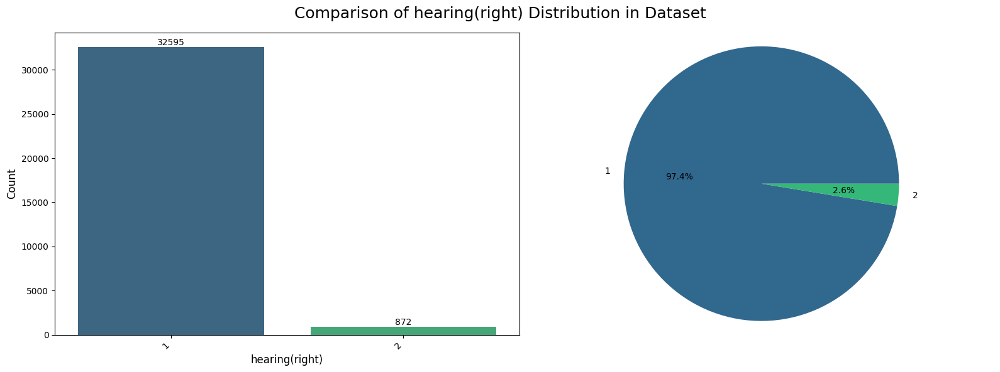

/tmp/ipython-input-705419456.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=value_counts.index, y=value_counts.values, palette="viridis", ax=ax1)
/tmp/ipython-input-705419456.py:13: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45, ha='right', fontsize=10)


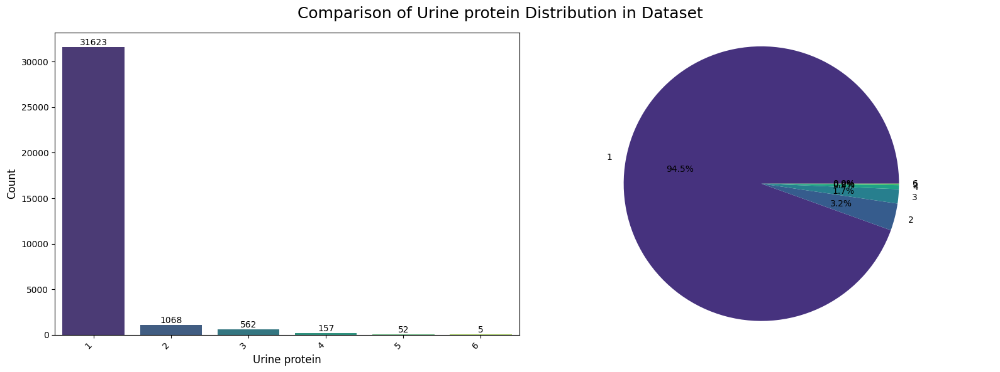

/tmp/ipython-input-705419456.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=value_counts.index, y=value_counts.values, palette="viridis", ax=ax1)
/tmp/ipython-input-705419456.py:13: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45, ha='right', fontsize=10)


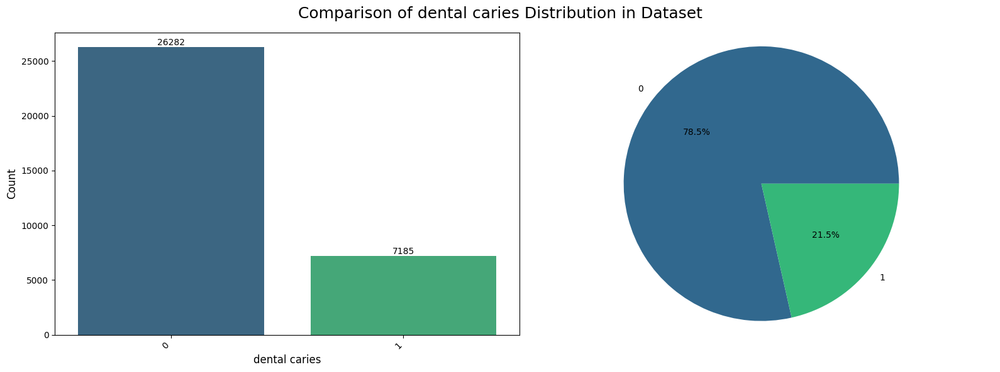

/tmp/ipython-input-705419456.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=value_counts.index, y=value_counts.values, palette="viridis", ax=ax1)
/tmp/ipython-input-705419456.py:13: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45, ha='right', fontsize=10)


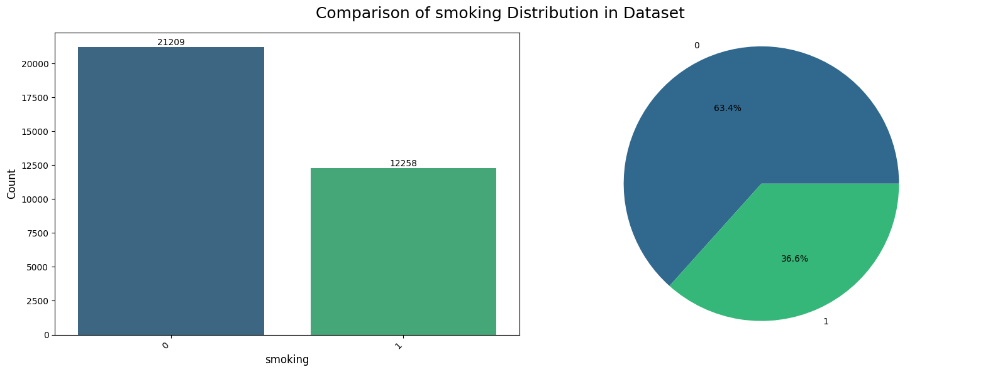

In [15]:
# Plot the distribuition of a column
def plot_distribution(df, column):
    # Calculate value counts
    value_counts = df[column].value_counts()

    # Create a figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

    # Bar plot on the first subplot
    sns.barplot(x=value_counts.index, y=value_counts.values, palette="viridis", ax=ax1)
    ax1.set_xlabel(column, fontsize=12)
    ax1.set_ylabel('Count', fontsize=12)
    ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45, ha='right', fontsize=10)

    # Add data labels above each bar
    for index, value in enumerate(value_counts):
        ax1.text(index, value, str(value), ha='center', va='bottom', fontsize=10)

    # Pie plot on the second subplot
    ax2.pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', colors=sns.color_palette("viridis", len(value_counts)))
    ax2.axis('equal')

    # Main title for the figure
    fig.suptitle(f'Comparison of {column} Distribution in Dataset', fontsize=18)

    # Adjust layout and display the figure
    plt.tight_layout()
    plt.show()

# for each categorical column plots the distribution of each value
for column in categorical_cols:
    plot_distribution(df, column)

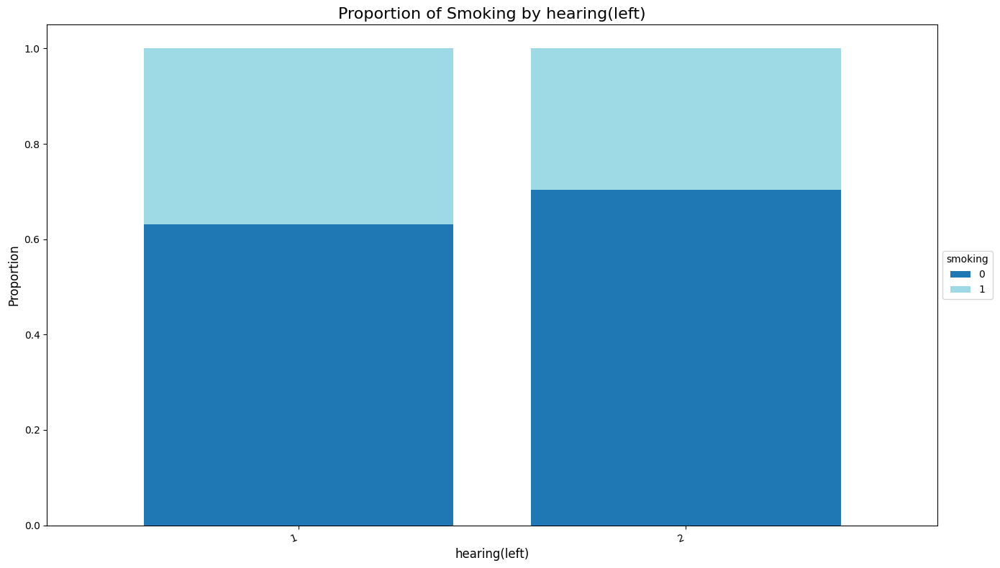

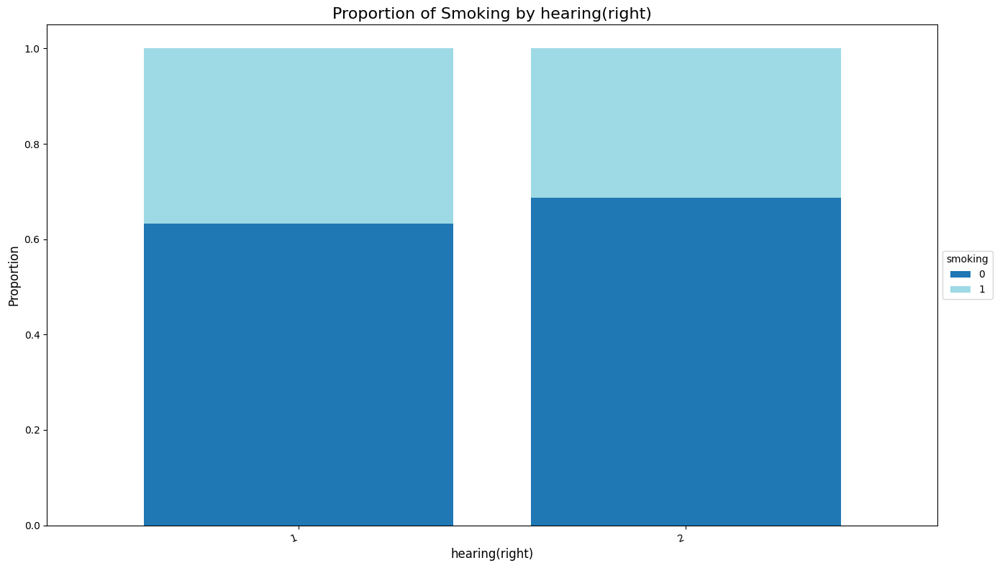

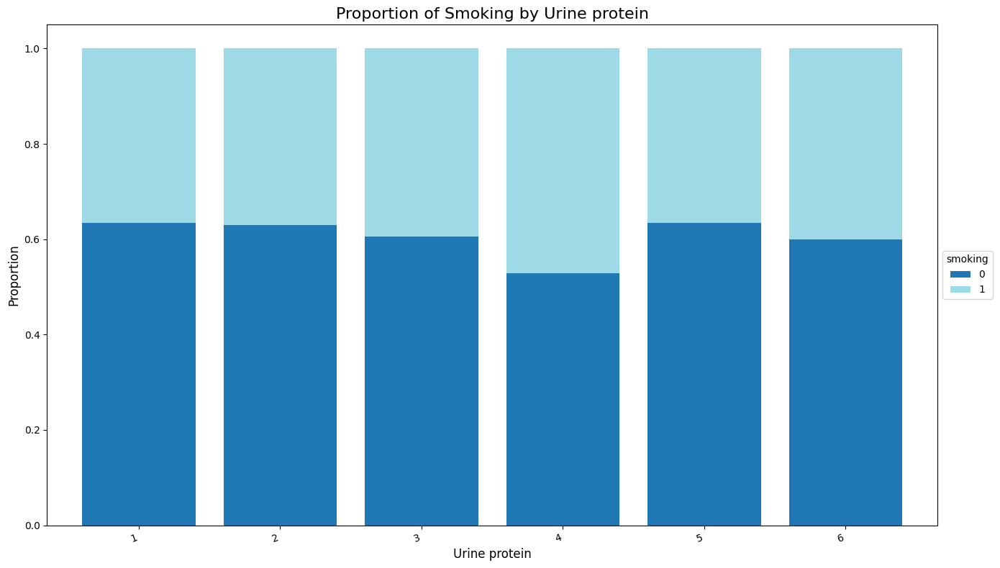

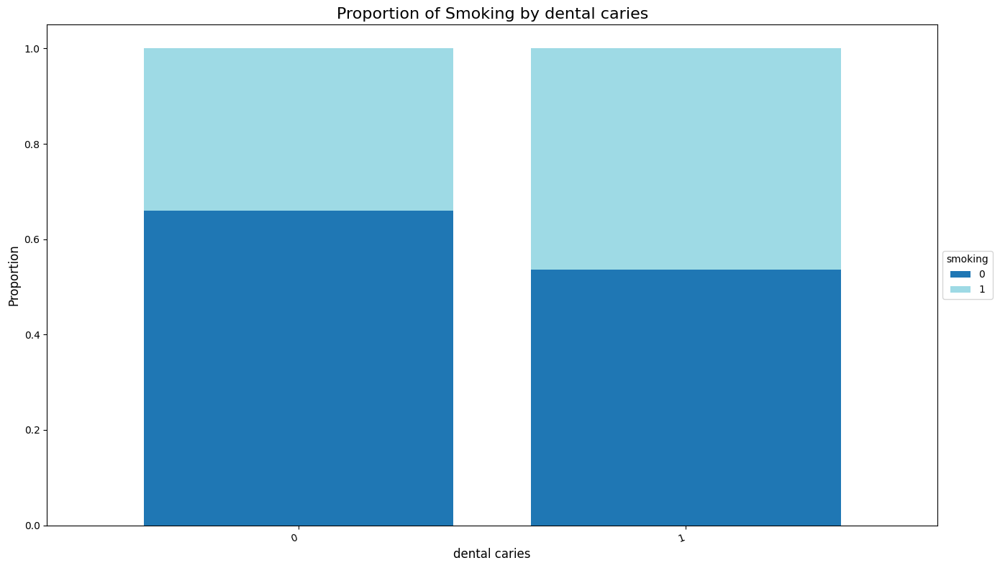

In [16]:
for cat in categorical_cols:
    if cat == 'smoking':
      continue

    plt.figure(figsize=(14, 8))

    # Compute normalized proportions for each feature class
    prop_df = df.groupby(cat)['smoking'].value_counts(normalize=True).unstack()
    #prop_df = prop_df.reindex(columns=output_order)

    # Plot proportional bar chart
    prop_df.plot(
        kind='bar',
        stacked=True,
        ax=plt.gca(),
        cmap='tab20', # Use a qualitative colormap
        width=0.8
    )

    # 5. Set titles and labels
    plt.title('Proportion of Smoking by '+cat, fontsize=16)
    plt.xlabel(cat, fontsize=12)
    plt.ylabel('Proportion', fontsize=12)
    plt.xticks(rotation=20, ha='right') # Rotate x-axis labels for readability

    # 6. Place the legend outside the plot
    plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), title='smoking')

    # Adjust layout to prevent legend from being cut off
    plt.tight_layout()
    plt.show()

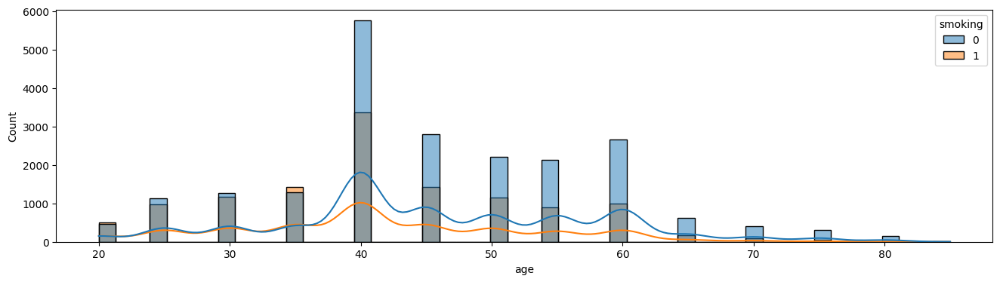

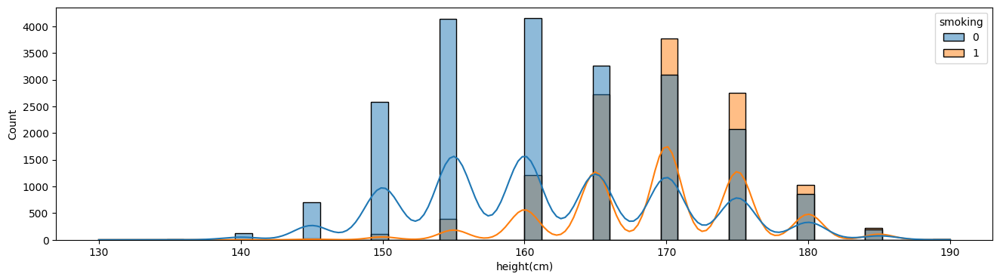

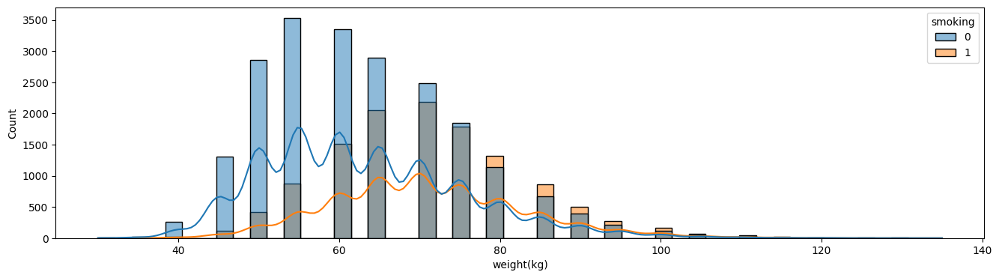

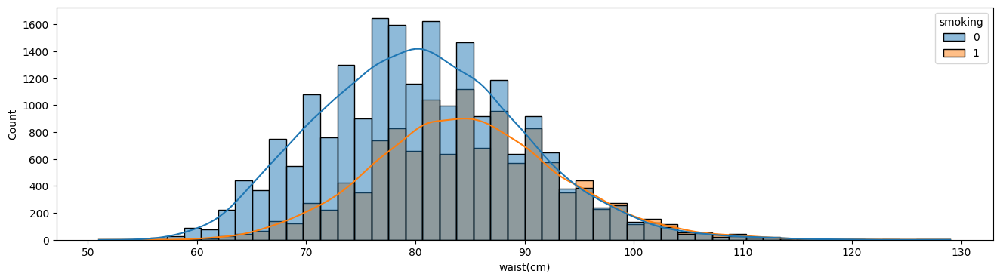

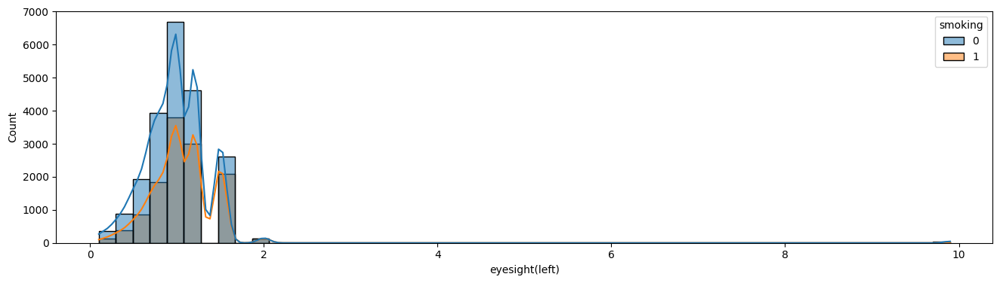

...

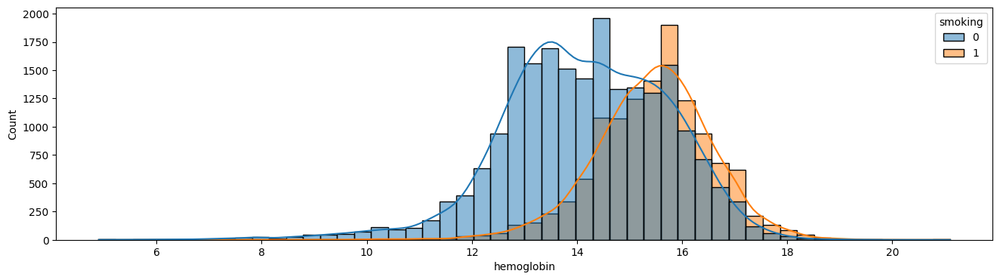

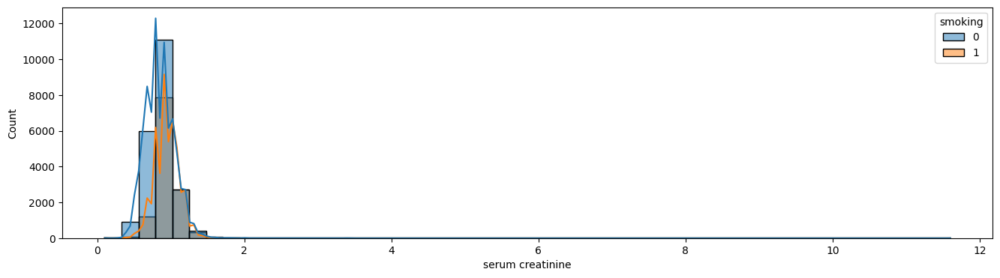

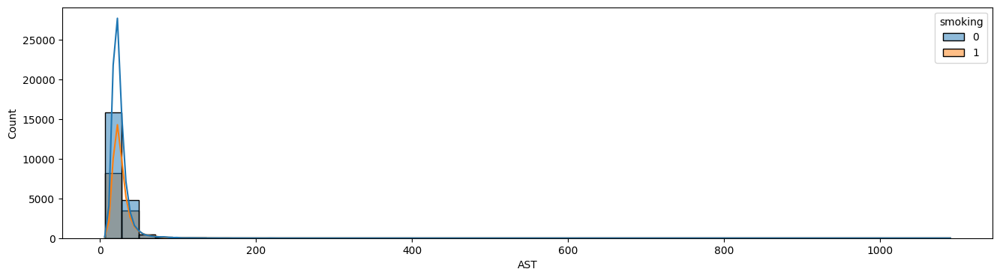

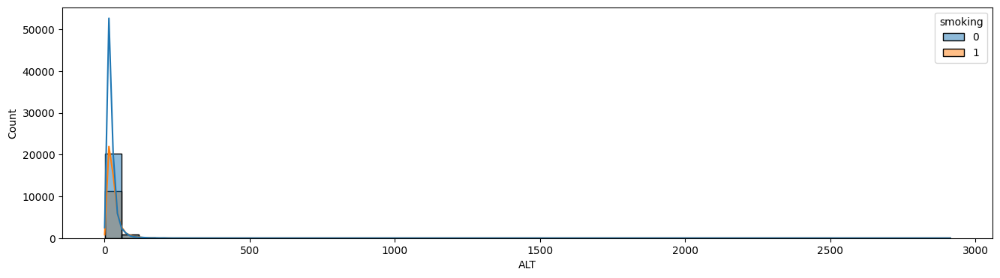

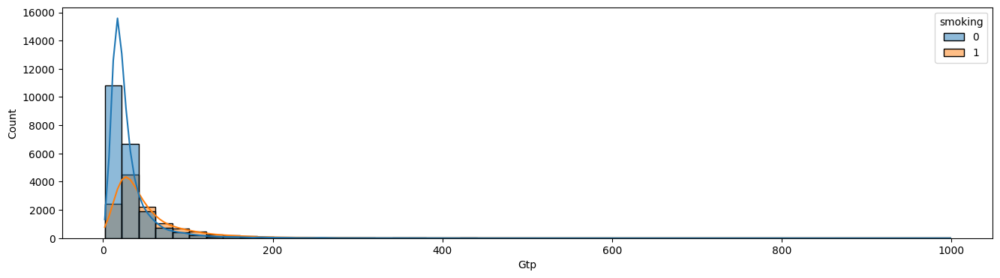

In [18]:
# Plot a histogram of a column with the amount of column for each obesity result
def plot_histograms_and_density(dataframe, column):
    fig, ax = plt.subplots(figsize=(16, 4))
    fig = sns.histplot(data=dataframe, x=column, hue="smoking", bins=50, kde=True)
    #plt.ylim(0,500)
    plt.show()

# plot the histograms of the continuous columns
for column in continuous_cols:
    plot_histograms_and_density(df, column)

## Bivariate Analysis

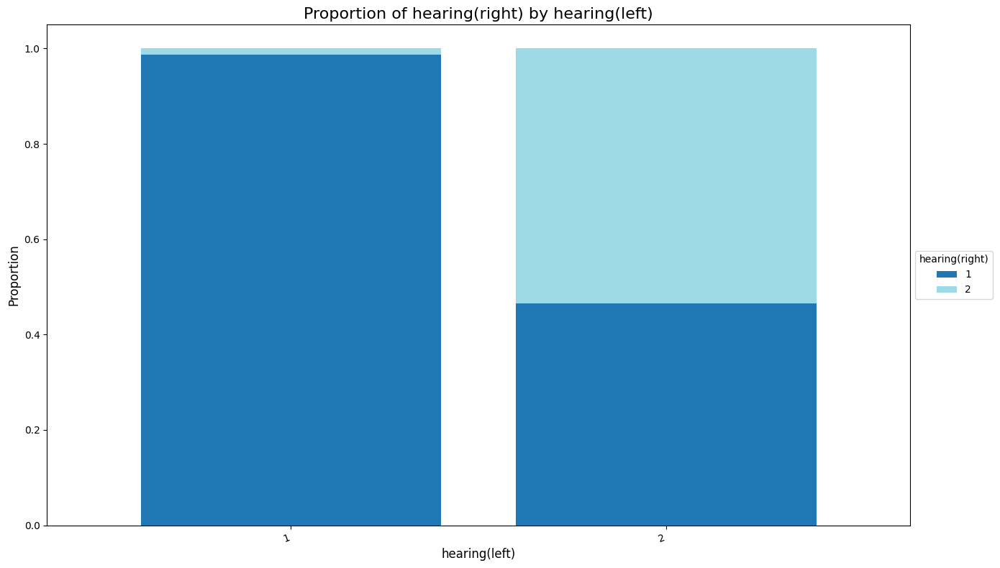

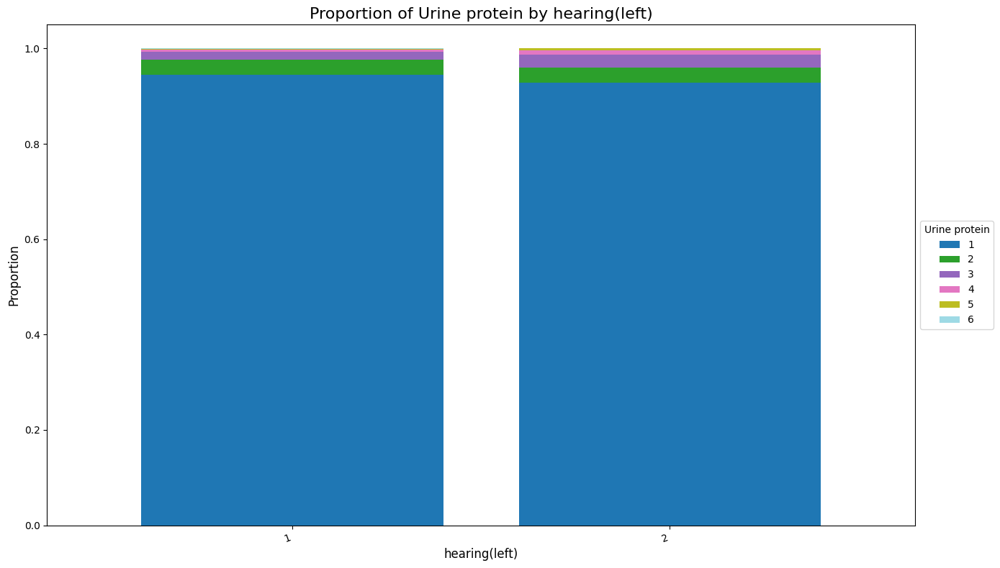

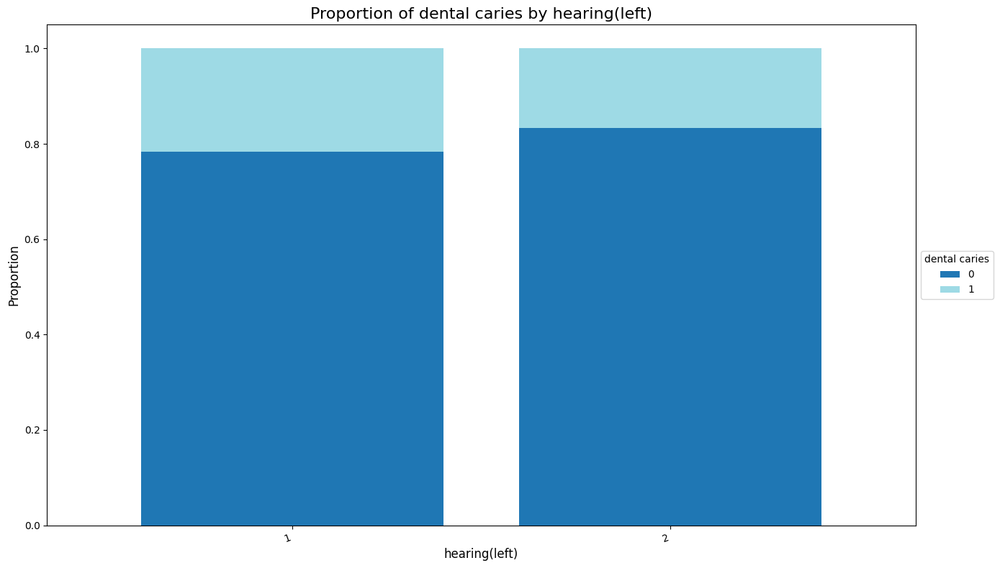

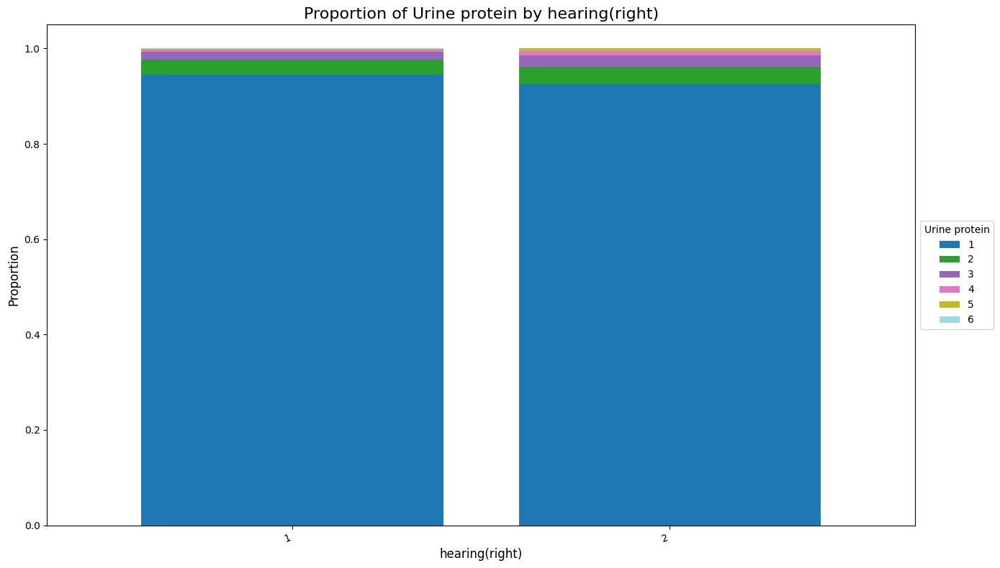

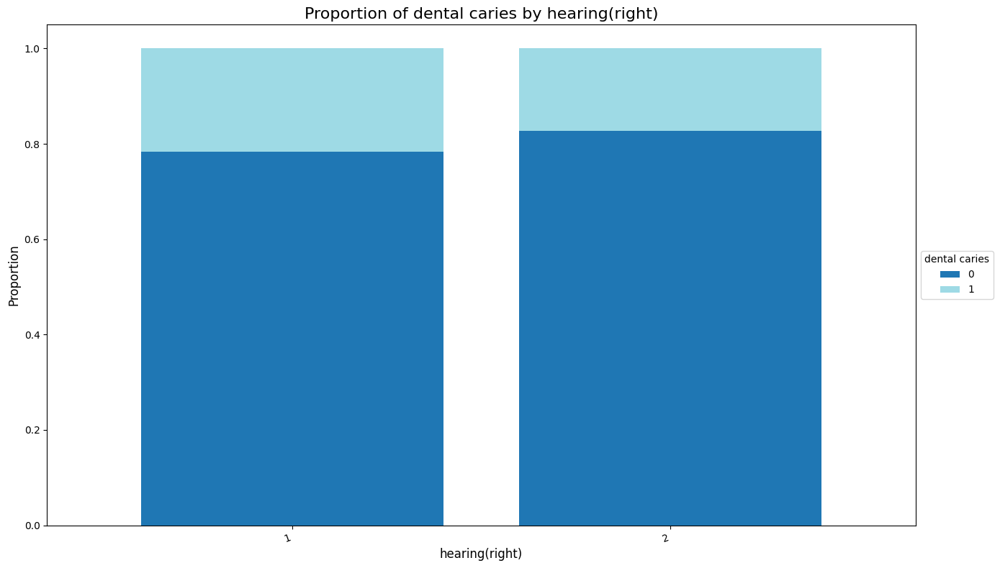

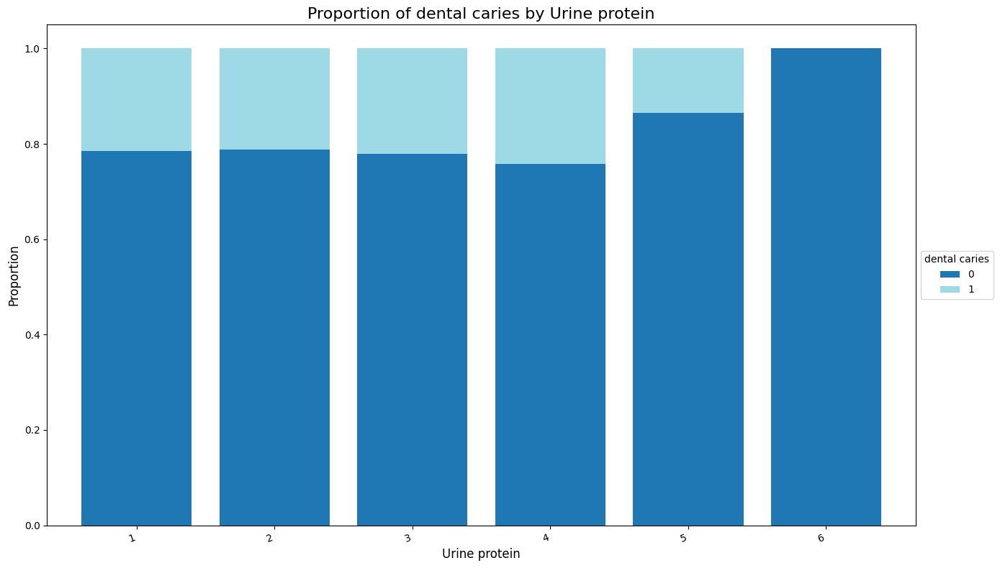

In [32]:
for i in range(len(categorical_cols)-1):
  for j in range(i+1, len(categorical_cols)-1):
    cat = categorical_cols[i]
    col = categorical_cols[j]

    plt.figure(figsize=(14, 8))

    # Compute normalized proportions for each feature class
    prop_df = df.groupby(cat)[col].value_counts(normalize=True).unstack()
    #prop_df = prop_df.reindex(columns=output_order)

    # Plot proportional bar chart
    prop_df.plot(
        kind='bar',
        stacked=True,
        ax=plt.gca(),
        cmap='tab20', # Use a qualitative colormap
        width=0.8
    )

    # 5. Set titles and labels
    plt.title('Proportion of '+col+' by '+cat, fontsize=16)
    plt.xlabel(cat, fontsize=12)
    plt.ylabel('Proportion', fontsize=12)
    plt.xticks(rotation=20, ha='right') # Rotate x-axis labels for readability

    # 6. Place the legend outside the plot
    plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), title=col)

    # Adjust layout to prevent legend from being cut off
    plt.tight_layout()
    plt.show()

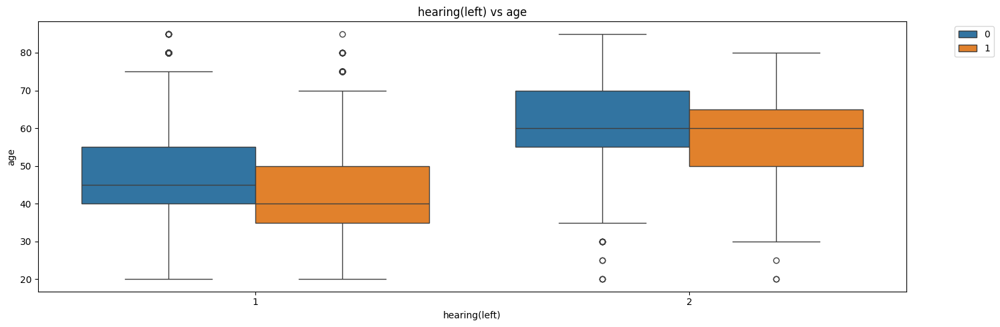

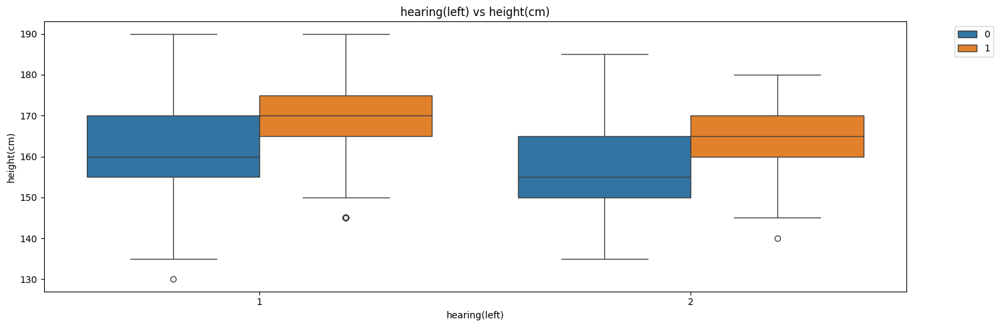

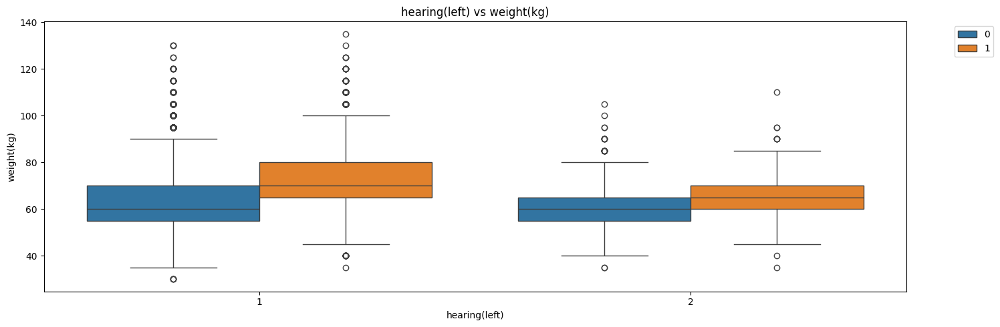

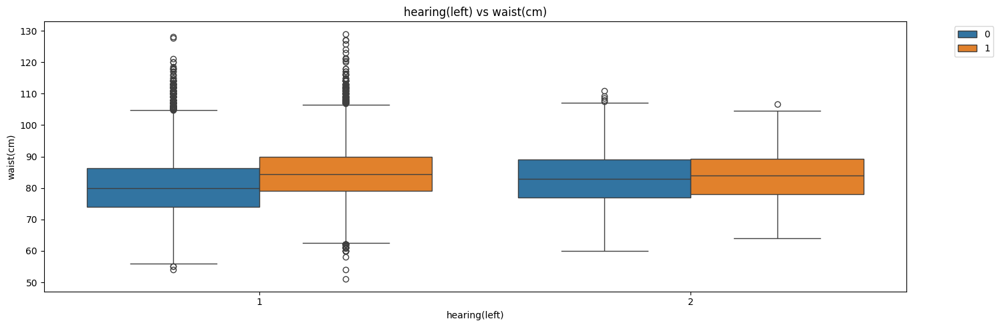

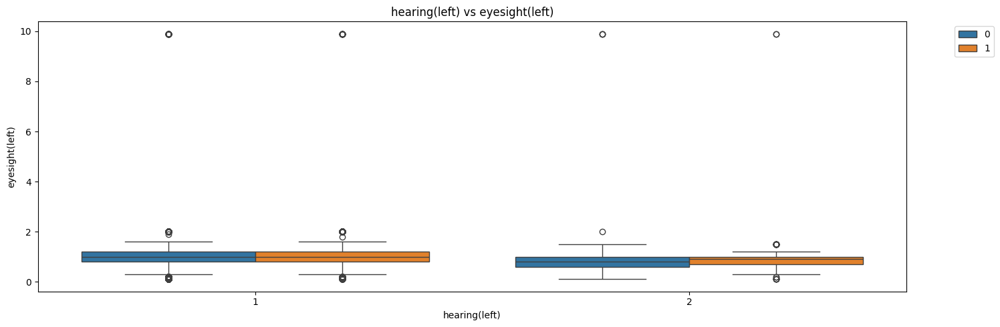

...

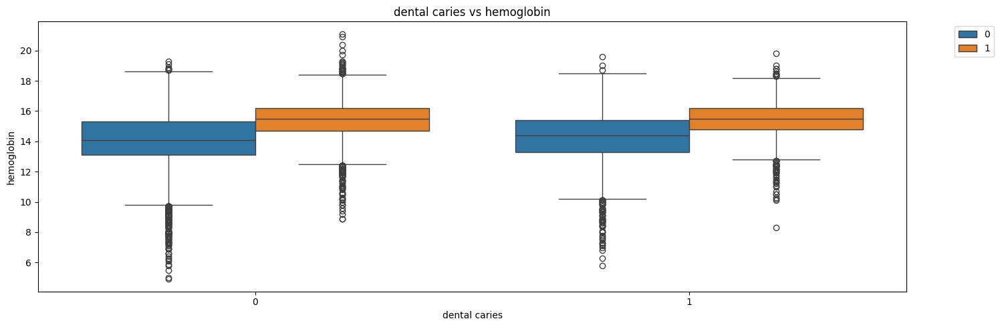

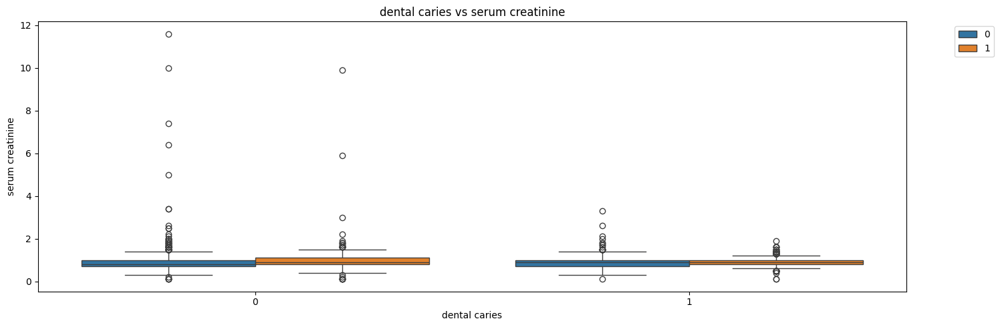

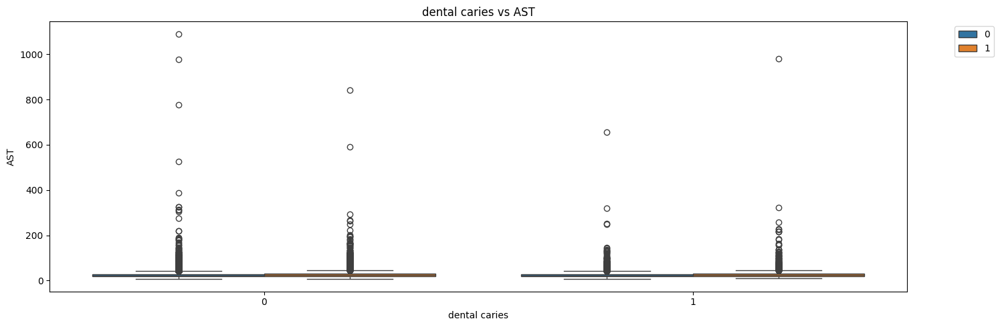

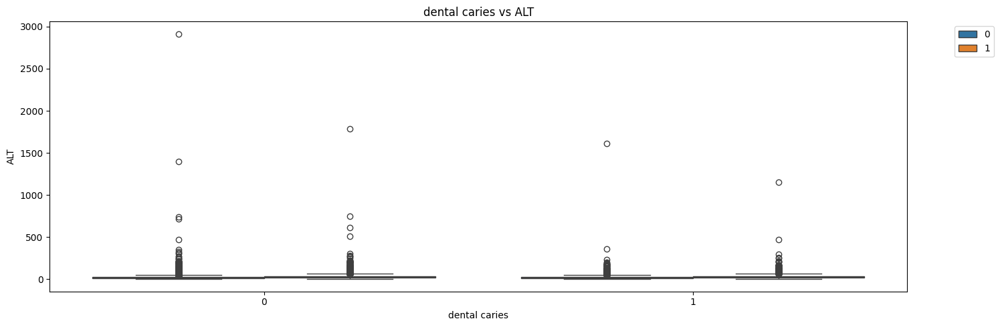

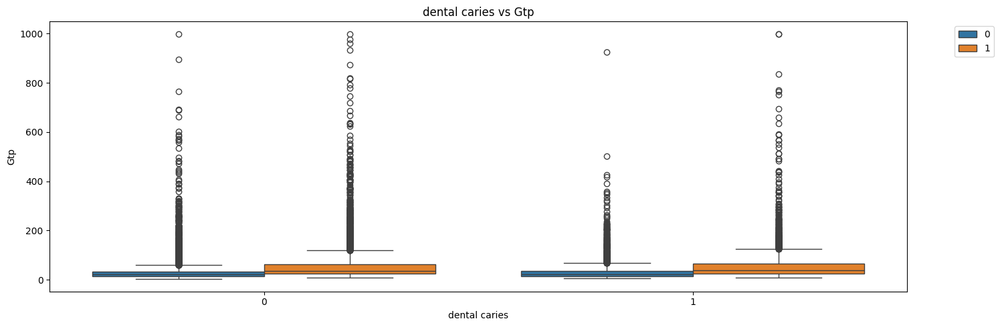

In [33]:
for cat in categorical_cols:
    for con in continuous_cols:
        if cat == 'smoking':
            continue  # skip plotting against the target column

        plt.figure(figsize=(15, 5))

        sns.boxplot(
                data=df,
                x=cat,
                y=con,
                hue='smoking',
            )

        plt.title(f"{cat} vs {con}")
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.tight_layout()
        plt.show()

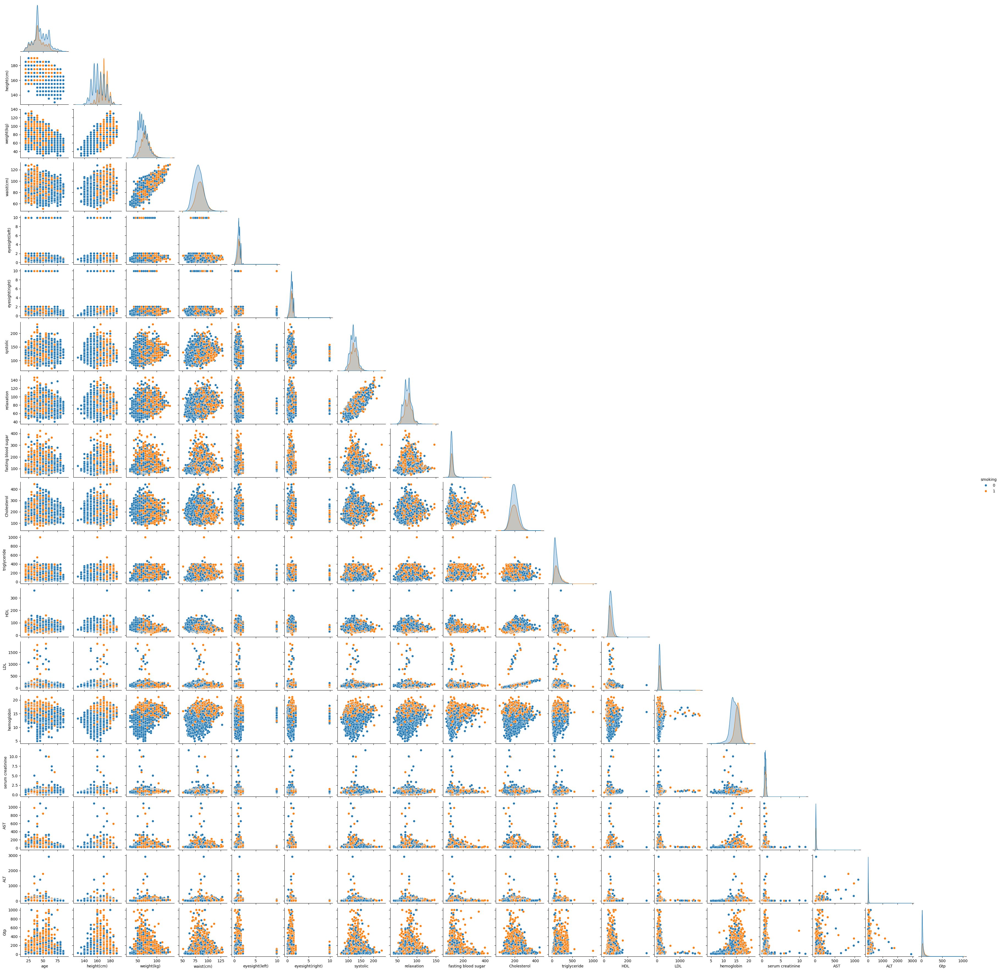

In [34]:
sns.pairplot(data=df, vars=continuous_cols, hue='smoking', corner=True, height=2)
plt.show()

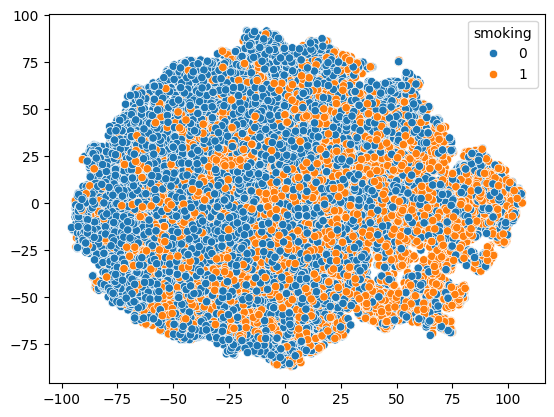

In [37]:
from sklearn.manifold import TSNE

dfcontinuous = df[continuous_cols]

# Apply t-SNE
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(dfcontinuous)

# Plot
sns.scatterplot(x=tsne_results[:, 0], y=tsne_results[:, 1], hue=df['smoking'])
plt.show()

In [19]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 23/23 [00:01<00:00, 20.65it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [20]:
df.corr()

,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,relaxation,...,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,smoking
age,1.000000,-0.480895,-0.325477,-0.027102,-0.188223,-0.191772,0.201783,0.206624,0.132698,0.048420,...,0.008542,0.042201,-0.265176,0.027302,-0.103534,0.024776,-0.068117,0.011256,-0.114453,-0.167149
height(cm),-0.480895,1.000000,0.674440,0.378102,0.148935,0.155562,-0.080843,-0.077712,0.081960,0.114901,...,-0.214256,-0.046486,0.536684,0.005957,0.380073,0.049771,0.131471,0.138305,0.082872,0.393353
weight(kg),-0.325477,0.674440,1.000000,0.824670,0.106812,0.113585,-0.051866,-0.052600,0.268257,0.273645,...,-0.360734,0.036844,0.488798,0.028447,0.317505,0.128865,0.251306,0.208699,0.076743,0.298142
waist(cm),-0.027102,0.378102,0.824670,1.000000,0.030696,0.039640,0.021513,0.019740,0.319275,0.292969,...,-0.376196,0.067237,0.380360,0.042277,0.227246,0.146302,0.250358,0.240273,0.047576,0.222772
eyesight(left),-0.188223,0.148935,0.106812,0.030696,1.000000,0.344406,-0.046549,-0.048374,-0.013939,0.007209,...,-0.020914,-0.009331,0.095610,-0.008831,0.057848,-0.005718,0.021620,0.002949,0.007668,0.060057
eyesight(right),-0.191772,0.155562,0.113585,0.039640,0.344406,1.000000,-0.037448,-0.035238,-0.008341,0.014646,...,-0.023854,-0.009145,0.096334,-0.011849,0.046424,-0.002092,0.027579,0.017128,0.016921,0.061988
hearing(left),0.201783,-0.080843,-0.051866,0.021513,-0.046549,-0.037448,1.000000,0.515184,0.057027,0.009255,...,-0.019587,-0.019266,-0.031862,0.016755,0.002216,0.007901,0.000446,0.008369,-0.018637,-0.023257
hearing(right),0.206624,-0.077712,-0.052600,0.019740,-0.048374,-0.035238,0.515184,1.000000,0.048229,-0.001151,...,-0.014450,-0.017944,-0.031806,0.017939,0.010476,0.010023,0.001365,0.005014,-0.016541,-0.018060
systolic,0.132698,0.081960,0.268257,0.319275,-0.013939,-0.008341,0.057027,0.048229,1.000000,0.760592,...,-0.084175,0.013581,0.185114,0.047986,0.073218,0.086324,0.093492,0.171435,0.034406,0.070407
relaxation,0.048420,0.114901,0.273645,0.292969,0.007209,0.014646,0.009255,-0.001151,0.760592,1.000000,...,-0.088440,0.035765,0.234729,0.052067,0.087911,0.086530,0.103912,0.178580,0.036322,0.104472


Text(0.5, 1.0, 'Correlation of Features')

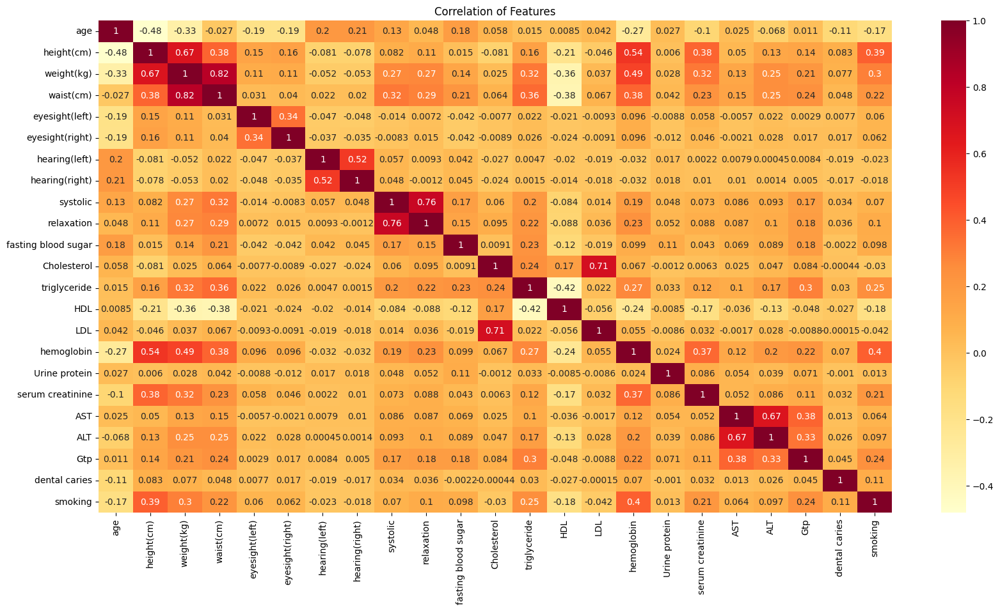

In [21]:
plt.figure(figsize=(20, 10))
sns.heatmap(df.corr(),annot=True , cmap ='YlOrRd' )
plt.title("Correlation of Features")